In [1]:
import pandas as pd
import seaborn as sns
import jams
import matplotlib.pyplot as plt
import numpy as np


Bad key xtick.labelcolor in file /home/bmcfee/.config/matplotlib/stylelib/bauhaus.mplstyle, line 5 ('xtick.labelcolor: black')
You probably need to get an updated matplotlibrc file from
https://github.com/matplotlib/matplotlib/blob/v3.3.1/matplotlibrc.template
or from the matplotlib source distribution

Bad key ytick.labelcolor in file /home/bmcfee/.config/matplotlib/stylelib/bauhaus.mplstyle, line 9 ('ytick.labelcolor: black')
You probably need to get an updated matplotlibrc file from
https://github.com/matplotlib/matplotlib/blob/v3.3.1/matplotlibrc.template
or from the matplotlib source distribution


In [2]:
df = pd.read_csv('chord_vs_expanded.csv', index_col=0)

In [3]:
df.head(3).T

,TR6R91L11C8A40D710,TRACGVT149E3B9BE3F,TRACPPB149E33C10B9
thirds,0.790809,0.785753,0.695705
thirds_inv,0.784065,0.785753,0.675099
triads,0.635357,0.785753,0.66047
triads_inv,0.635357,0.785753,0.648579
tetrads,0.391648,0.740552,0.420274
tetrads_inv,0.391648,0.740552,0.418807
root,0.790809,0.785753,0.695705
mirex,0.702273,0.785753,0.704188
majmin,0.82185,0.785753,0.758788
majmin_inv,0.82185,0.785753,0.745126


In [4]:
sns.set_style('whitegrid')

In [5]:
robust = True

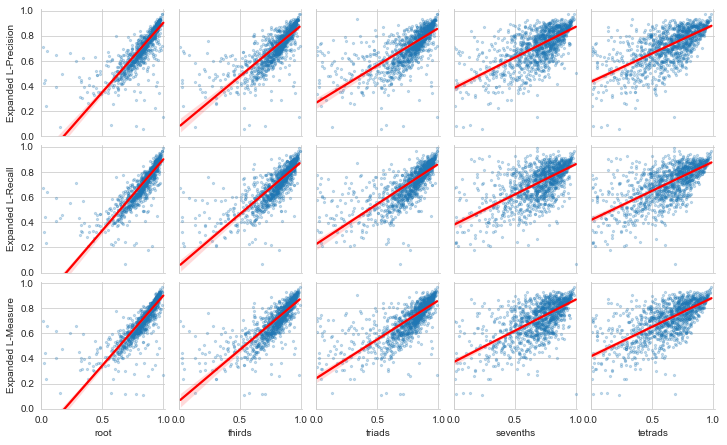

In [28]:
g = sns.PairGrid(df, 
                         x_vars=['root', 'thirds', 'triads', 'sevenths', 'tetrads'], 
                         y_vars=['Expanded L-Precision', 'Expanded L-Recall', 'Expanded L-Measure'], height=2.0)
g.map(sns.regplot, robust=robust, n_boot=100, line_kws=dict(color='r'), scatter_kws=dict(alpha=0.25, marker='.', s=5))
g.set(xlim=(0, 1.01), ylim=(0, 1.01))
fig = plt.gcf()
fig.savefig('chord-results.svg', transparent=True, format='svg')

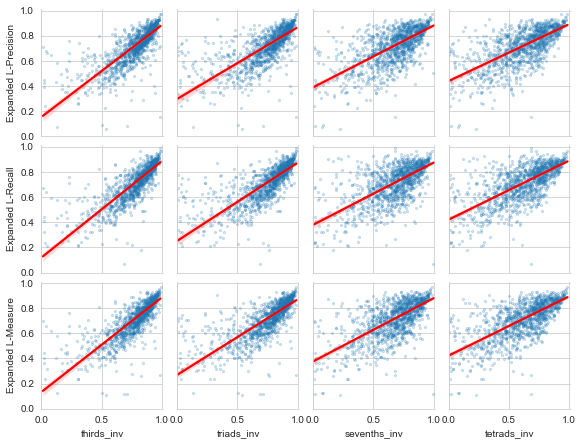

In [26]:
g = sns.PairGrid(df, 
                         x_vars=['thirds_inv', 'triads_inv', 'sevenths_inv', 'tetrads_inv'], 
                         y_vars=['Expanded L-Precision', 'Expanded L-Recall', 'Expanded L-Measure'], height=2.0)
g.map(sns.regplot, robust=robust, n_boot=100, line_kws=dict(color='r'), scatter_kws=dict(alpha=0.2, marker='.', s=5))
g.set(xlim=(0, 1.01), ylim=(0, 1.01))
fig = plt.gcf()
fig.savefig('chord-results-inv.svg', transparent=True, format='svg')

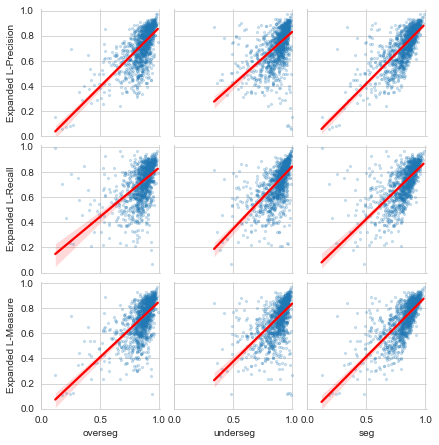

In [27]:
g = sns.PairGrid(df, 
                         x_vars=['overseg', 'underseg', 'seg'], 
                         y_vars=['Expanded L-Precision', 'Expanded L-Recall', 'Expanded L-Measure'], height=2)
g.map(sns.regplot, robust=robust, n_boot=100, line_kws=dict(color='r'), scatter_kws=dict(alpha=0.2, marker='.', s=5))
g.set(xlim=(0, 1.01), ylim=(0, 1.01))
fig = plt.gcf()
fig.savefig('chord-results-seg.svg', transparent=True, format='svg')

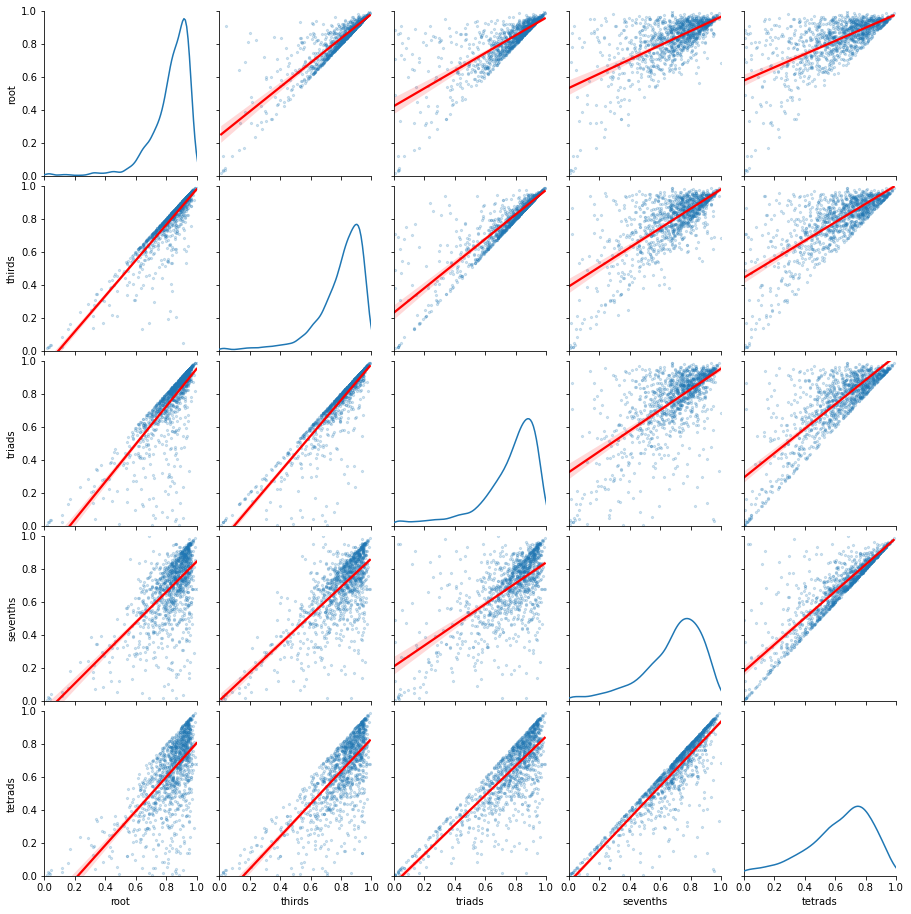

In [7]:
g = sns.PairGrid(df, vars=['root', 'thirds', 'triads', 'sevenths', 'tetrads'])
g.map_diag(sns.kdeplot)
g.map_offdiag(sns.regplot, line_kws=dict(color='r'), scatter_kws=dict(alpha=0.2, marker='.', s=5))
g.set(xlim=(0, 1), ylim=(0, 1))
#fig = plt.gcf()
#fig.savefig('chord-results.svg', transparent=True, format='svg')

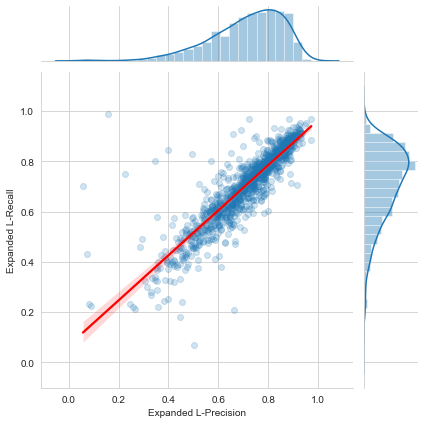

In [255]:
sns.jointplot('Expanded L-Precision', 'Expanded L-Recall', df, scatter_kws=dict(alpha=0.2), line_kws=dict(color='r'), kind='reg')

In [6]:
df.corr()

,thirds,thirds_inv,triads,triads_inv,tetrads,tetrads_inv,root,mirex,majmin,majmin_inv,sevenths,sevenths_inv,underseg,overseg,seg,Expanded L-Precision,Expanded L-Recall,Expanded L-Measure
thirds,1.000000,0.964828,0.900228,0.884590,0.744464,0.741217,0.893761,0.858458,0.949085,0.920500,0.713751,0.712398,0.415241,0.477040,0.538959,0.753972,0.787789,0.784806
thirds_inv,0.964828,1.000000,0.875769,0.909063,0.726952,0.754643,0.874676,0.830296,0.908578,0.947306,0.681841,0.720534,0.460762,0.451137,0.546953,0.749433,0.795871,0.785234
triads,0.900228,0.875769,1.000000,0.980172,0.813419,0.809723,0.783638,0.837720,0.856210,0.838721,0.629526,0.636538,0.413494,0.438257,0.512600,0.688322,0.732742,0.721360
triads_inv,0.884590,0.909063,0.980172,1.000000,0.800859,0.822007,0.778752,0.824342,0.838849,0.874048,0.617863,0.656016,0.450734,0.423265,0.523858,0.691525,0.744646,0.728151
tetrads,0.744464,0.726952,0.813419,0.800859,1.000000,0.990049,0.643921,0.681560,0.708728,0.697395,0.889537,0.885709,0.372233,0.526634,0.575582,0.653822,0.642012,0.664110
tetrads_inv,0.741217,0.754643,0.809723,0.822007,0.990049,1.000000,0.646094,0.680547,0.703953,0.726448,0.876889,0.898611,0.399225,0.517961,0.586059,0.659273,0.653626,0.672163
root,0.893761,0.874676,0.783638,0.778752,0.643921,0.646094,1.000000,0.808085,0.855726,0.840002,0.632135,0.635823,0.444666,0.396189,0.497826,0.765396,0.809378,0.793215
mirex,0.858458,0.830296,0.837720,0.824342,0.681560,0.680547,0.808085,1.000000,0.864719,0.841918,0.646849,0.649269,0.431895,0.380898,0.487042,0.672608,0.691707,0.686055
majmin,0.949085,0.908578,0.856210,0.838849,0.708728,0.703953,0.855726,0.864719,1.000000,0.961445,0.753083,0.746436,0.375407,0.476971,0.521103,0.722117,0.735807,0.741534
majmin_inv,0.920500,0.947306,0.838721,0.874048,0.697395,0.726448,0.840002,0.841918,0.961445,1.000000,0.723345,0.764147,0.427047,0.450172,0.533605,0.719598,0.748233,0.745408


In [11]:
pd.set_option('display.precision', 3)

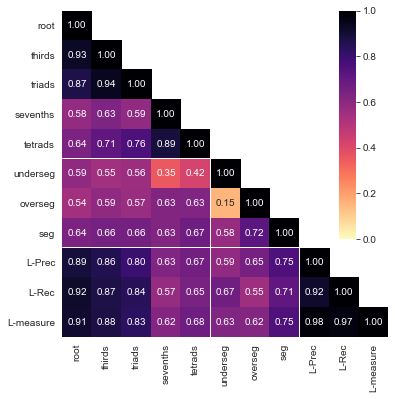

In [101]:
import matplotlib as mpl
METRICS = ['root', 'thirds', 'triads', 'sevenths', 'tetrads', 'underseg', 'overseg', 'seg', 'Expanded L-Precision', 'Expanded L-Recall', 'Expanded L-Measure']
sl = df[METRICS]
idx = sl.columns.to_list()
idx[-3:] = ['L-Prec', 'L-Rec', 'L-measure']
sl.columns = idx
corr = sl.corr(method='spearman')
mask = np.triu(np.ones_like(corr, dtype=np.bool), k=1)
fig, ax = plt.subplots(figsize=(6, 6))

cbaxes = ax.inset_axes((0.85, 0.3, 0.05, 0.7))
sns.heatmap(corr, mask=mask, vmin=0, vmax=1, cmap='magma_r', square=True, annot=True, fmt='0.2f', ax=ax,
              cbar=True, cbar_ax=cbaxes)

ax.axhline(4.975, linewidth=1, color='w', alpha=1)
ax.axvline(4.975, linewidth=1, color='w', alpha=1)
ax.axhline(7.975, linewidth=1, color='w', alpha=1)
ax.axvline(7.975, linewidth=1, color='w', alpha=1)
fig.savefig('chord-correlations.svg', format='svg', transparent=True)

In [8]:
SEGMETRICS = ['underseg', 'overseg', 'seg', 'Expanded L-Measure']
df[SEGMETRICS].corr()

,underseg,overseg,seg,Expanded L-Measure
underseg,1.000000,-0.044115,0.559637,0.532598
overseg,-0.044115,1.000000,0.740232,0.592069
seg,0.559637,0.740232,1.000000,0.708433
Expanded L-Measure,0.532598,0.592069,0.708433,1.000000


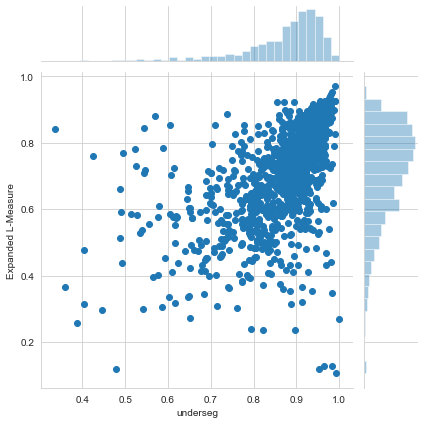

In [296]:
sns.jointplot('underseg', 'Expanded L-Measure', data=df)

---

Individual cases

In [9]:
from pathlib import Path
import jams.display
import matplotlib.pyplot as plt
from IPython.display import display, Audio

def display_annotation(idx, ax=None):
    J = jams.load(str(Path('data/merged/') / (str(idx) + '.jams')))
    
    if ax is None:
        ax = plt.gca()
        
    jams.display.display(J.annotations['chord', 0], meta=False, label='Reference', alpha=0.5, ax=ax)
    jams.display.display(J.annotations['chord', 1], meta=False, label='Estimate', alpha=0.5, ax=ax)
    
    ax.legend(loc='lower left', bbox_to_anchor=(0, 1), ncol=2)
    ax.set(xlabel='Time [seconds]', title='')
    ax.set_title('{1} - {2} [{0}]'.format(idx, J.file_metadata.artist, J.file_metadata.title), loc='right')
    
METRICS = ['root', 'thirds', 'triads', 'sevenths', 'tetrads', 'Expanded L-Measure']

def display_scores(df, track, ax=None):
    if ax is None:
        ax = plt.gca()
        
    scores = df.loc[track][METRICS]
    index = scores.index.tolist()
    index[-1] = 'Hierarchy'
    scores.index = index
    scores.name = 'Score'
    
    return pd.plotting.table(ax, scores.apply(lambda x: '{:0.3f}'.format(x)),
                                  bbox=(1.1, 0, 0.1, 1), rowLoc='left', cellLoc='right', edges='B')
    
def display_audio(idx):
    display(Audio(filename=str(Path('/home/bmcfee/data/chords/') / (str(idx) + '.mp3'))))

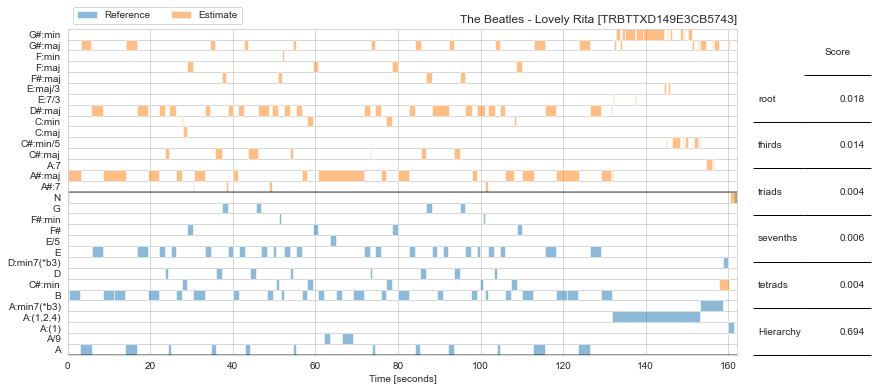

In [243]:
fig, ax = plt.subplots(figsize=(12, 6))

track = (df['Expanded L-Measure'] - df['root']).idxmax()

display_audio(track)
display_annotation(track, ax=ax)
tab = display_scores(df, track, ax=ax)
fig.savefig('l-high-root-low.svg', transparent=True, format='svg', bbox_extra_artists=[tab])

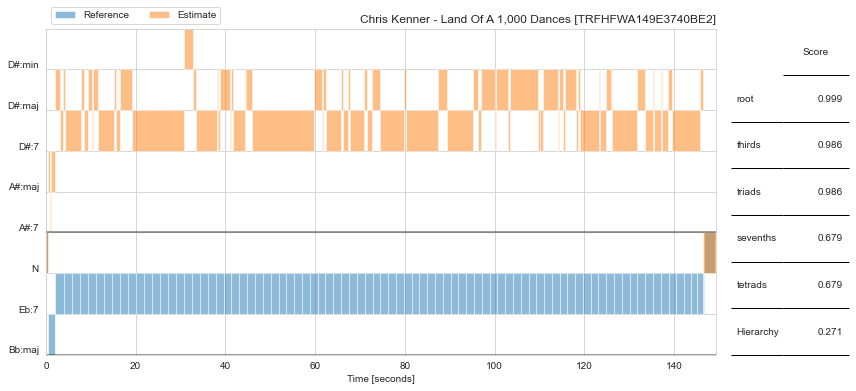

In [300]:
fig, ax = plt.subplots(figsize=(12, 6))

track = (df['Expanded L-Measure'] - df['root']).sort_values(ascending=True).index[1]

display_audio(track)
display_annotation(track, ax=ax)
display_scores(df, track, ax=ax)

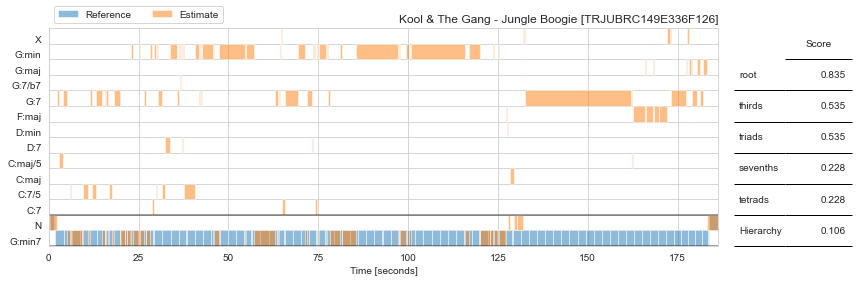

In [244]:
fig, ax = plt.subplots(figsize=(12, 4))

track = (df['Expanded L-Measure'] - df['root']).idxmin()

display_audio(track)
display_annotation(track, ax=ax)
tab = display_scores(df, track, ax=ax)
fig.savefig('l-low-root-high.svg', transparent=True, format='svg', bbox_extra_artists=[tab])

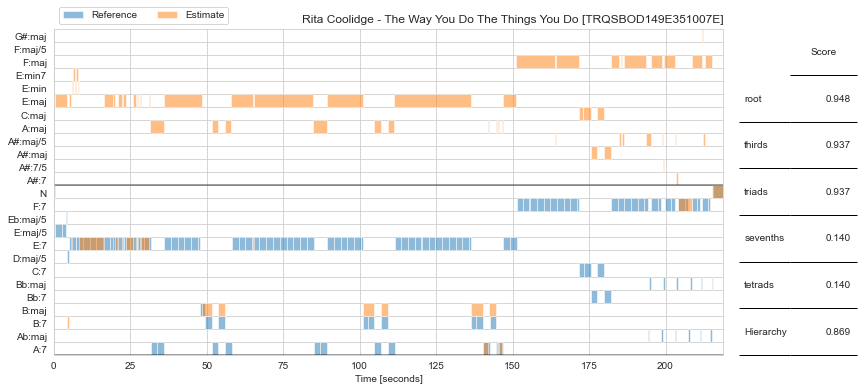

In [245]:
fig, ax = plt.subplots(figsize=(12, 6))

track = (df['Expanded L-Measure'] - df['tetrads']).idxmax()

display_audio(track)
display_annotation(track, ax=ax)
tab = display_scores(df, track, ax=ax)
fig.savefig('l-high-tetrads-low.svg', transparent=True, format='svg', bbox_extra_artists=[tab])

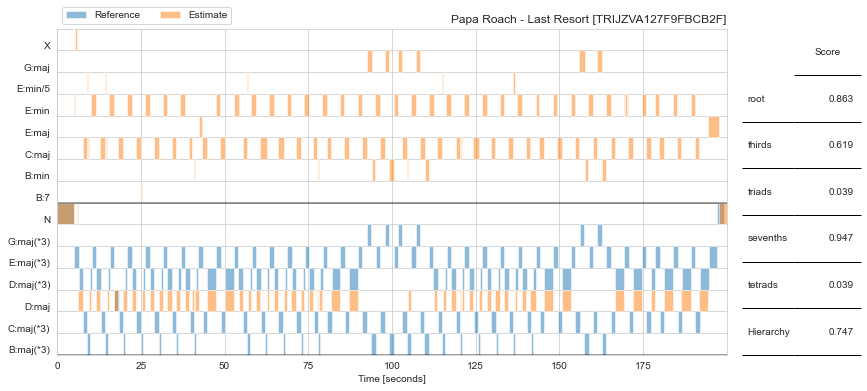

In [307]:
fig, ax = plt.subplots(figsize=(12, 6))

track = (df['Expanded L-Measure'] - df['tetrads']).sort_values(ascending=False).index[2]

display_audio(track)
display_annotation(track, ax=ax)
tab = display_scores(df, track, ax=ax)
fig.savefig('l-high-tetrads-low2.svg', transparent=True, format='svg', bbox_extra_artists=[tab])

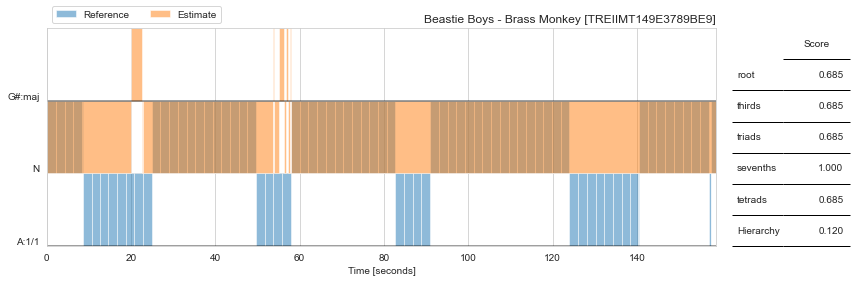

In [246]:
fig, ax = plt.subplots(figsize=(12, 4))

track = (df['Expanded L-Measure'] - df['tetrads']).idxmin()

display_audio(track)
display_annotation(track, ax=ax)
tab = display_scores(df, track, ax=ax)
fig.savefig('l-low-tetrads-high.svg', transparent=True, format='svg', bbox_extra_artists=[tab])

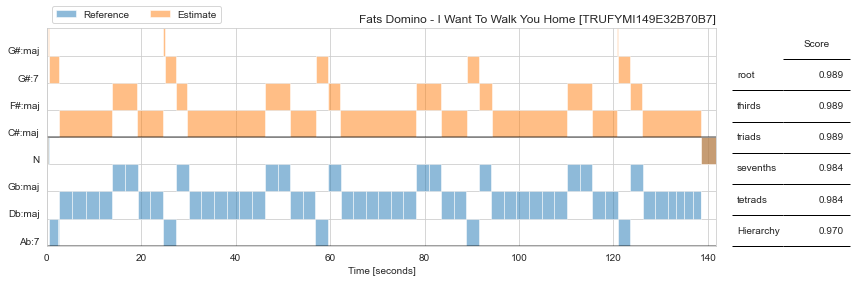

In [289]:
fig, ax = plt.subplots(figsize=(12, 4))

track = (df['Expanded L-Measure']).idxmax()

display_audio(track)
display_annotation(track, ax=ax)
tab = display_scores(df, track, ax=ax)
fig.savefig('l-high.svg', transparent=True, format='svg', bbox_extra_artists=[tab])

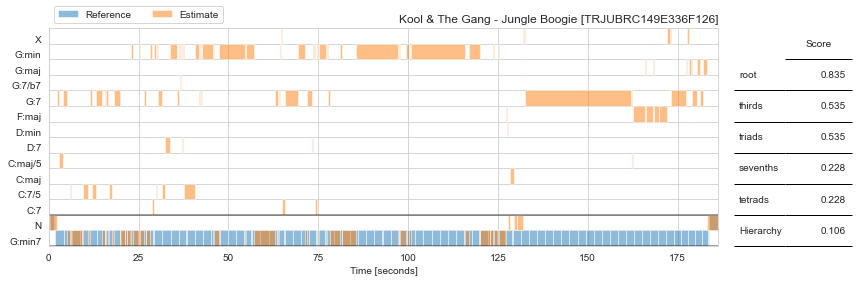

In [292]:
fig, ax = plt.subplots(figsize=(12, 4))

track = (df['Expanded L-Measure']).idxmin()

display_audio(track)
display_annotation(track, ax=ax)
tab = display_scores(df, track, ax=ax)
fig.savefig('l-low.svg', transparent=True, format='svg', bbox_extra_artists=[tab])

---
# Demonstrative examples

In [109]:
import os
import jams
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import jams.display
from tqdm import tqdm_notebook as tqdm
import pandas as pd
from joblib import Parallel, delayed
import mir_eval
import pumpp
from copy import deepcopy

In [110]:
def getid(fname):
    return os.path.splitext(os.path.basename(fname))[0]

In [111]:
def issame(labs1, labs2):
    
    # Hash the strings
    h1 = [hash(_) for _ in labs1]
    h2 = [hash(_) for _ in labs2]
    
    # Build the segment label agreement matrix
    a1 = np.equal.outer(h1, h1)
    a2 = np.equal.outer(h2, h2)
    
    # Labelings are the same if the segment label agreements are identical
    return np.all(a1 == a2)


### Functions to create the hierarchies

In [112]:
def rootX(label, root):
    
    if label == 'X':
        return f'{root}:{label}'
        
    return label

def chord_to_hier(ann):
    """Creates a hierarchy from chord information"""
    
    # Do the isolations for each observed chord
    C3 = pumpp.task.ChordTagTransformer(vocab='3')
    C35 = pumpp.task.ChordTagTransformer(vocab='35')
    C3567s = pumpp.task.ChordTagTransformer(vocab='3567s')
    
    # Create object to place the annotations into
    ann_h = jams.Annotation('multi_segment',
                            time=ann.time,
                            duration=ann.duration,
                            annotation_metadata=ann.annotation_metadata)
    
    for obs in ann:
        og_chord = obs.value
        if ':' in og_chord:
            root, dressing = og_chord.split(':', 2)
            # Isolate the enharmonically unique root
            root = C3567s.simplify(root)
            root = root[:root.index(':')] 
            root_change = root + ':' + dressing
        else:
            # Isolate the enharmonically unique root
            root = C3567s.simplify(og_chord)
            if ':' in root:
                root = root[:root.index(':')] 
            root_change = root

        # Make first level with the root only 
        ann_h.append(time=obs.time, duration=obs.duration,
                    value=dict(level=1, label=root),
                    confidence=obs.confidence)
        
        # Add the maj/min designation to the root in level 2
        ann_h.append(time=obs.time, duration=obs.duration,
                    value=dict(level=2, label=rootX(C3.simplify(obs.value), root)),
                    confidence=obs.confidence)
        
        # Add aug/dim to the above
        ann_h.append(time=obs.time, duration=obs.duration,
                    value=dict(level=3, label=rootX(C35.simplify(obs.value), root)),
                    confidence=obs.confidence)
        
        # Above plus maj6/min6 & 7/min7/maj7/dim7/hdim7/minmaj7
        # Only inversions dropped here
        ann_h.append(time=obs.time, duration=obs.duration,
                    value=dict(level=4, label=rootX(C3567s.simplify(obs.value), root)),
                    confidence=obs.confidence)
        
        # Just the root changed (but inversions kept)
        ann_h.append(time=obs.time, duration=obs.duration,
                    value=dict(level=5, label=root_change),
                    confidence=obs.confidence)
        
        # Original string 
        ann_h.append(time=obs.time, duration=obs.duration,
                    value=dict(level=6, label=obs.value),
                    confidence=obs.confidence)
    return ann_h

In [113]:
def hier_pruned(_ann_h):
    """Prune the levels in the hierarchy that are the same as the previous one. """
    
    # Make a copy of the hierarchy
    ann_ph = deepcopy(_ann_h)
    
    # Flatten the annotations and zip the pairs of information together
    h_intervals, h_labels = jams.eval.hierarchy_flatten(ann_ph)
    ann_z = zip(h_intervals, h_labels)
    ann_z = list(ann_z)
    
    # Remove the old segment data
    ann_ph.pop_data()
    
    # Determine the height of the input hierarchy:
    max_level = len(ann_z)    
    
    
    # Initialize the pruned heirarchy
    
    # Start with the lowest level
    level = 0
    # Create first part of the hierarchy
    ints, labs = ann_z[0]
    for ival, label in zip(ints, labs):
        ann_ph.append(time=ival[0], duration=ival[1]-ival[0], value=dict(label=label, level=level))
        
    # Advanced the level marker
    level += 1
    # Set previous ints and labs as new variables
    prev_ints = ints
    prev_labs = labs
    
    
    # For each remaining level in the hierarchy, check that the level is adding something new 
    #     that is not contained in the previous level
    for i in range(1, max_level):
        
        # Extract the new level
        ints, labs = ann_z[i]
        
        # Only add if this level is different than the previous one: 
        if not issame(prev_labs, labs):
            for ival, label in zip(ints, labs):
                ann_ph.append(time=ival[0], duration=ival[1]-ival[0], value=dict(label=label, level=level))
            
            # If a level was added, then update comparison point and update the level marker
            # Advanced the level marker
            level += 1
            # Set previous ints and labs as new variables
            prev_ints = ints
            prev_labs = labs
    
    #print(level)
    return ann_ph

#### Local testing

In [114]:
def mplot(test_ann_h, **kwargs):
    hier_ints, hier_labs = jams.eval.hierarchy_flatten(test_ann_h)
    
    for n in range(len(hier_labs)):
        for m in range(len(hier_labs[n])):
            hier_labs[n][m] = ' ' * n + hier_labs[n][m]
            
    return mir_eval.display.hierarchy(hier_ints, hier_labs, **kwargs)

In [117]:
a_demo = jams.Annotation('chord', duration=10)
a_demo.append(0, 1, value='C:7')
a_demo.append(1, 1, value='B#')
a_demo.append(2, 1, value='C:min/5')
a_demo.append(3, 1, value='C:9/5')
a_demo.append(4, 1, value='Db:sus4(13)')
h_demo = chord_to_hier(a_demo)

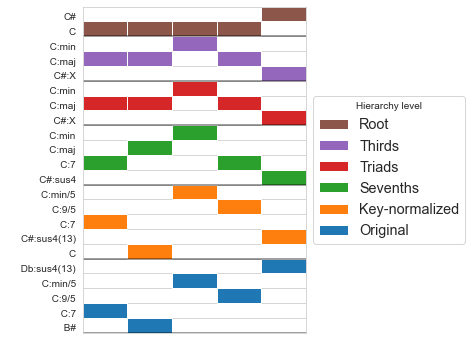

In [118]:
fig, ax = plt.subplots(figsize=(4, 6))
mplot(h_demo, ax=ax, levels=['Original', 'Key-normalized', 'Sevenths', 'Triads', 'Thirds', 'Root'][::-1])    
handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1],  loc='center left', bbox_to_anchor=(1, 0.5), fontsize='x-large', title='Hierarchy level')
ax.set(xticks=[]);
fig.savefig('chord-hierarchy.svg', format='svg', transparent=True)